In [42]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

In [43]:
data = pd.read_csv(r"C:\Users\baner\Downloads\Music-Recommendation-System\data.csv")
genre_data = pd.read_csv(r'C:\Users\baner\Downloads\Music-Recommendation-System\data_by_genres.csv')
year_data = pd.read_csv(r'C:\Users\baner\Downloads\Music-Recommendation-System\data_by_year.csv')

In [44]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [45]:
print(genre_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB
None


In [46]:
print(year_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB
None


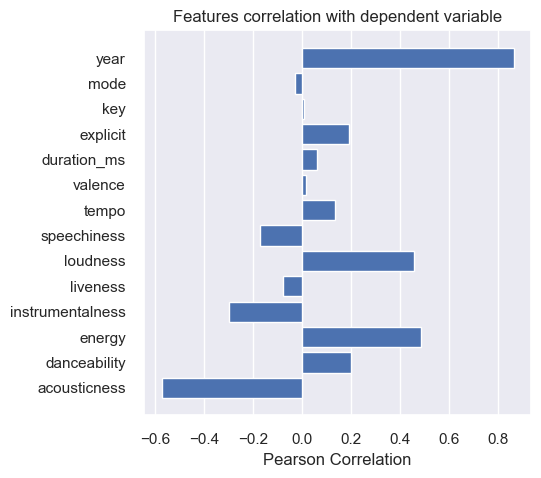

<Axes: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [47]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(5,5)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

In [48]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    return decade

data['decade'] = data['year'].apply(get_decade)


<Axes: xlabel='decade', ylabel='count'>

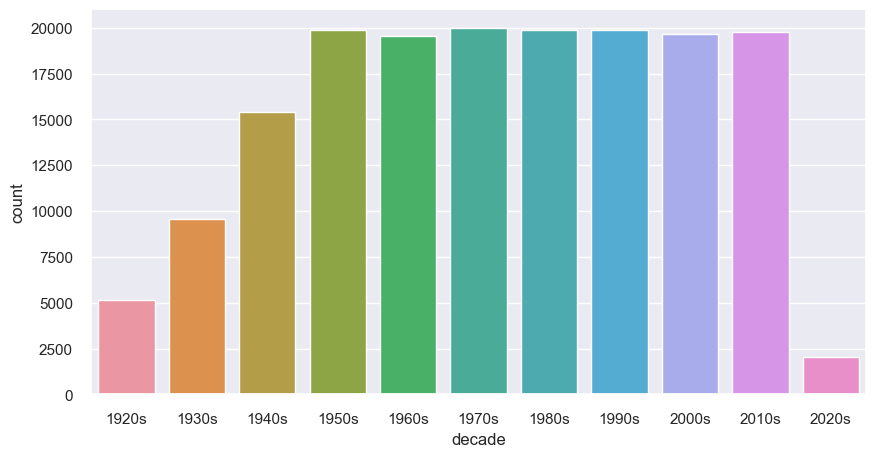

In [49]:

sns.set(rc={'figure.figsize':(10 ,5)})
sns.countplot(x='decade', data=data)


In [50]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

In [51]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

## Clustering Genres with K-Means

In [52]:
from sklearn.pipeline import make_pipeline
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Assuming genre_data is a DataFrame and np has been imported as numpy

# Create a pipeline and fit it in one go
cluster_pipeline = make_pipeline(StandardScaler(), KMeans(n_clusters=10))
genre_data['cluster'] = cluster_pipeline.fit_predict(genre_data.select_dtypes(include=[np.number]))


In [53]:
from sklearn.manifold import TSNE
from sklearn.manifold import TSNE
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
import pandas as pd
import plotly.express as px

# Create a pipeline and apply t-SNE transformation in one step
tsne_pipeline = make_pipeline(StandardScaler(), TSNE(n_components=2, verbose=1, random_state=42))
projection = pd.DataFrame(tsne_pipeline.fit_transform(genre_data.select_dtypes(include=[np.number])),
                          columns=['x', 'y'])
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

# Create the scatter plot
fig = px.scatter(projection, x='x', y='y', color='cluster', hover_data=['genres'])
fig.show()


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.007s...
[t-SNE] Computed neighbors for 2973 samples in 0.754s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.807987
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.071854
[t-SNE] KL divergence after 1000 iterations: 1.180786


## Clustering Songs with K-Means

In [54]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()),
                                  ('kmeans', KMeans(n_clusters=20,
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [55]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()


## Build Recommender System

In [56]:
!pip install spotipy

In [57]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id='2ec23f19cfba4134916753a3420df57f',
                                                           client_secret='816a15a8848e4c18b9c5d2167a15d751'))



def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

In [58]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):

    try:
        song_data = spotify_data[(spotify_data['name'] == song['name'])
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data

    except IndexError:
        return find_song(song['name'], song['year'])


def get_mean_vector(song_list, spotify_data):

    song_vectors = []

    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)

    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):

    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []

    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)

    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=10):

    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)

    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])

    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

In [59]:
recommend_songs([{'name': 'Numb', 'year':2000}],  data)

[{'name': "What He Don't Know", 'year': 2013, 'artists': "['Anarbor']"},
 {'name': 'Take My Life', 'year': 2002, 'artists': "['Jeremy Camp']"},
 {'name': 'Angel of Darkness - Video Mix',
  'year': 2003,
  'artists': "['Alex C.', 'Yasmin K.']"},
 {'name': 'You Fight Me', 'year': 2006, 'artists': "['Breaking Benjamin']"},
 {'name': 'Long Forgotten Sons', 'year': 2008, 'artists': "['Rise Against']"},
 {'name': 'Breaking Inside (feat. Lzzy Hale of Halestorm)',
  'year': 2008,
  'artists': "['Shinedown']"},
 {'name': 'Stand Up', 'year': 2008, 'artists': "['Fireflight']"},
 {'name': 'Miracle', 'year': 2007, 'artists': "['Paramore']"},
 {'name': "Something's Missing", 'year': 2003, 'artists': "['John Mayer']"}]

In [60]:
recommend_songs([{'name': "What He Don't Know", 'year': 2013}], data)

[{'name': 'Playing God', 'year': 2009, 'artists': "['Paramore']"},
 {'name': 'Numb', 'year': 2000, 'artists': "['Disturbed']"},
 {'name': 'Ready Set Go (feat. Capital Kings) (feat. Capital Kings)',
  'year': 2013,
  'artists': "['Royal Tailor', 'Capital Kings']"},
 {'name': 'Runaway', 'year': 2009, 'artists': "['Love and Theft']"},
 {'name': 'Stand Up', 'year': 2008, 'artists': "['Fireflight']"},
 {'name': 'Fast', 'year': 2015, 'artists': "['Luke Bryan']"},
 {'name': 'The Sharpest Lives',
  'year': 2006,
  'artists': "['My Chemical Romance']"},
 {'name': 'Take My Life', 'year': 2002, 'artists': "['Jeremy Camp']"},
 {'name': 'Alone', 'year': 2013, 'artists': "['Falling In Reverse']"}]

In [61]:
recommend_songs([{'name': 'You Fight Me', 'year': 2006, 'artists': "['Breaking Benjamin']"}], data)

[{'name': 'Hold Me Down', 'year': 2002, 'artists': "['Tommy Lee']"},
 {'name': 'Erase My Scars', 'year': 2010, 'artists': "['Evans Blue']"},
 {'name': 'Round And Round', 'year': 2012, 'artists': "['Imagine Dragons']"},
 {'name': 'Breaking Inside (feat. Lzzy Hale of Halestorm)',
  'year': 2008,
  'artists': "['Shinedown']"},
 {'name': 'Long Forgotten Sons', 'year': 2008, 'artists': "['Rise Against']"},
 {'name': 'Numb', 'year': 2000, 'artists': "['Disturbed']"},
 {'name': 'The High Road', 'year': 2012, 'artists': "['Three Days Grace']"},
 {'name': 'Ready To Fall', 'year': 2006, 'artists': "['Rise Against']"},
 {'name': 'Ready To Fall', 'year': 2006, 'artists': "['Rise Against']"}]

In [67]:
recommend_songs([{'name': 'Leave Out All The Rest', 'year': 2007 }], data)

[{'name': 'Inventame', 'year': 1999, 'artists': "['Marco Antonio Solís']"},
 {'name': 'Make It To Christmas', 'year': 2019, 'artists': "['Alessia Cara']"},
 {'name': 'Nada Valgo Sin Tu Amor', 'year': 2004, 'artists': "['Juanes']"},
 {'name': 'Yours to Keep', 'year': 2016, 'artists': "['Jordan Mackampa']"},
 {'name': 'What Would You Do', 'year': 2013, 'artists': "['Bastille']"},
 {'name': 'Uncover', 'year': 2012, 'artists': "['Zara Larsson']"},
 {'name': 'Despicable', 'year': 2018, 'artists': "['grandson']"},
 {'name': 'Hurricane', 'year': 2013, 'artists': "['MS MR']"},
 {'name': 'Jungle',
  'year': 2015,
  'artists': "['X Ambassadors', 'Jamie N Commons']"}]